# Q1 Hands-On Image Processing

In [1]:
import os
import cv2
import numpy as np

import matplotlib.pyplot as plt

# 0. Images Available
Given snapshots from CCTV from various views, let's start by defining some business questions that we can potentially answer.
Here are some of the questions one might have:

1. Quantity related: Information related to size (proportional to weight) of chicken
Can we identifying fully grown chickens? Identifying fully grown chicken gives the farmer an idea on how to plan ahead, eg when to brought in more chicken, is the growth rate of chicken as expected etc., and derive indirect insights about his

2. Flock status: Clusters identification
Do we have enough space and food for the chicken? Are the clusters spaced out enough, activeness of chicken(health monitoring) etc. This is essential to prvent chickens from fighting with each other for the essentials and to minimise the chances of infectious disease from spreading among the chickens. 

1 seems tricky for most of the views, as some chicken are relatively far away from the camera hence appeared to be smaller (unless we have other way of measuring the depth of photo, essentially we need to measure how far away the chicken are from the camera). Furthermore, if the farmer has been farming for long enough, he should understand the growth cycle of chicken well enough. Answering 1 might not add as much valuue to the farmer's business

Identifying clusters (and eventually monitoring them) seem to add more value to the farmer as it allows the farmer to better plan for his business, financially speaking. For example, the farmer can take action make internal partition for the chickens if internal fights between chickens are frequent. Or he can set up location for food and water more optimally based on how he would like the clusters to spaced out. For these reasons, I'm interested to work on 2. 

Image 4 which captures the global view is the most suitable image for chicken clusters identification.

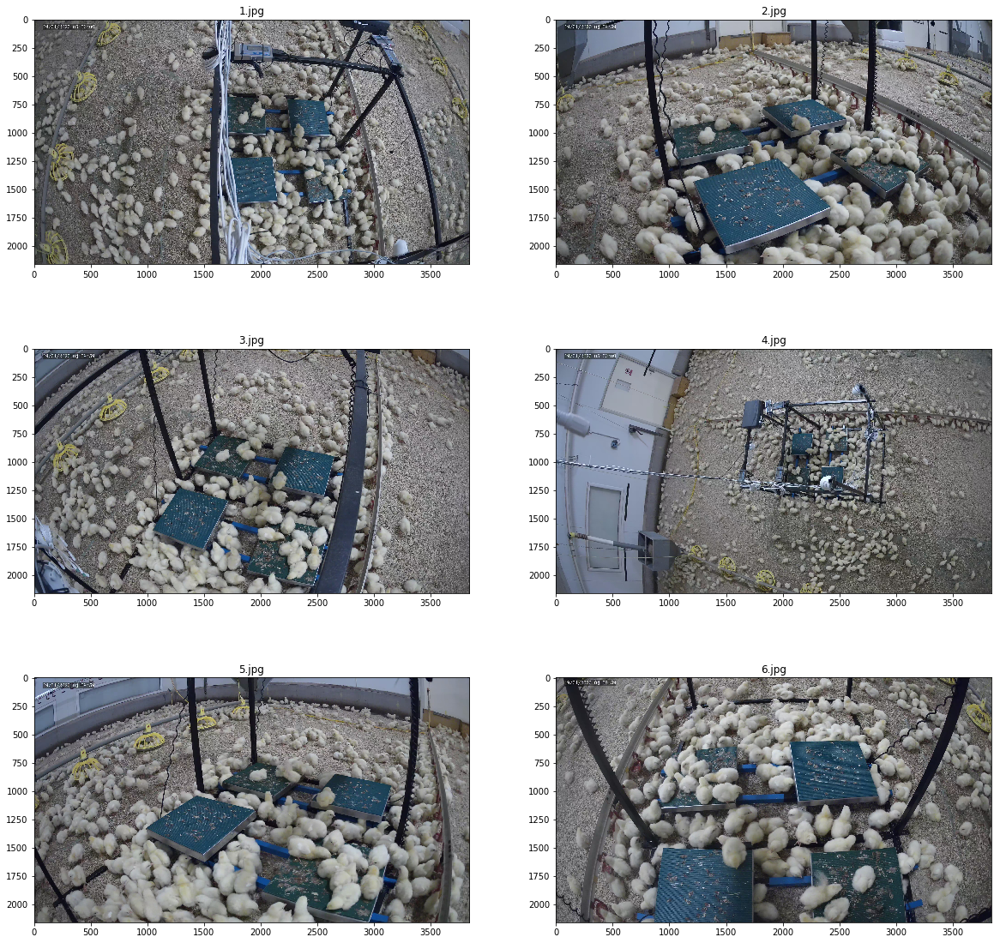

In [2]:
imgs = [f for f in os.listdir() if '.jpg' in f]
fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(20, 20))

for ix, ax in enumerate(axs.flat):
    
    img = plt.imread(imgs[ix])
    ax.imshow(img)
    ax.set_title(imgs[ix])

# 1. Clusters Identification
This is the first step -- identifying the clusters. Presented two types of methods, method A and B, with method B being an improvemnt on A.

In [3]:
import random
random.seed(42)

## Method A: Kmeans clustering (colour quantisation)
From what we can observed, chicken are more or less in the same colour. Hence, colour quantisation is a good starting point to segment out the chickens. We will be using kmeans clustering to determine a suitable colouring threshold. Note this is similar to global thresholding, we are just using k-means clustering to determine a range of pixel values for thresholding.

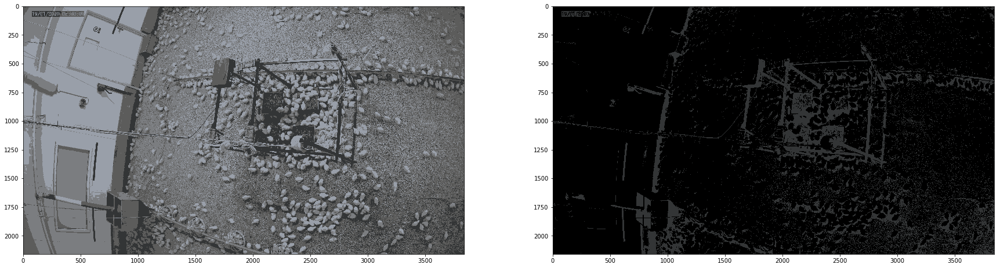

In [4]:
frame = cv2.imread(imgs[3])

Z = frame.reshape((-1,3))
Z = np.float32(Z)

# define criteria, number of clusters(K) and apply kmeans
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
K = 4
ret,label,center=cv2.kmeans(Z,K,None,criteria,10,cv2.KMEANS_RANDOM_CENTERS)

# Now convert back into uint8, and make original image
center = np.uint8(center)
res = center[label.flatten()]
res2 = res.reshape((frame.shape))

# Plotting
c = 1
mask = cv2.inRange(res2, center[c] - (1, 1, 1), center[c] + (1, 1, 1))
masked_frame = cv2.bitwise_and(res2, res2, mask=mask)

# quantised image in rgb format
res3 = cv2.cvtColor(res2, cv2.COLOR_BGR2RGB)

# masked quantised image in rgb format
masked_frame3 = cv2.cvtColor(masked_frame, cv2.COLOR_BGR2RGB)
fig, axs = plt.subplots(1, 2, figsize=(30, 30))
axs[0].imshow(res3)
axs[1].imshow(masked_frame3)

plt.show()

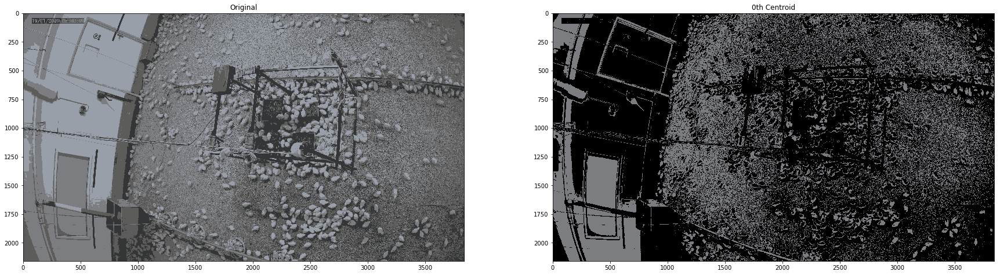

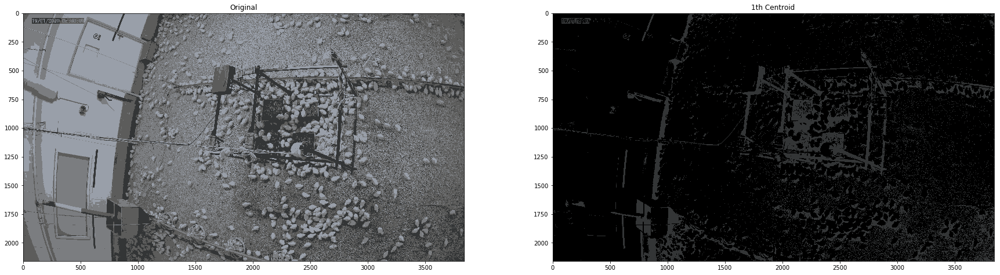

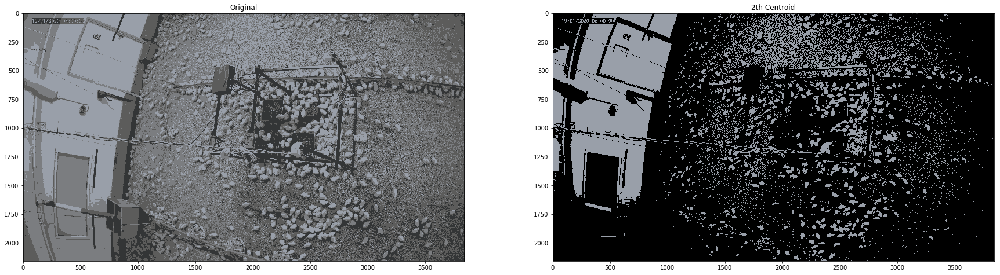

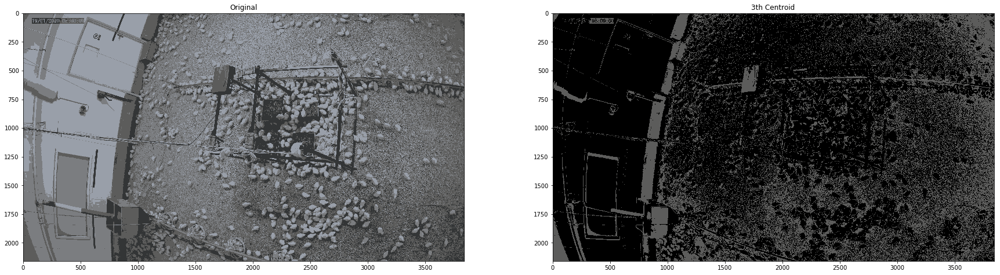

In [5]:
# Plotting
for c in range(4):
    mask = cv2.inRange(res2, center[c] - (10, 10, 10), center[c] + (10, 10, 10))
    masked_frame = cv2.bitwise_and(res2, res2, mask=mask)

    # quantised image in rgb format
    res3 = cv2.cvtColor(res2, cv2.COLOR_BGR2RGB)

    # masked quantised image in rgb format
    masked_frame3 = cv2.cvtColor(masked_frame, cv2.COLOR_BGR2RGB)
    fig, axs = plt.subplots(1, 2, figsize=(30, 30))
    axs[0].imshow(res3)
    axs[0].set_title('Original')
    
    axs[1].imshow(masked_frame3)
    axs[1].set_title('{}th Centroid'.format(c))
    plt.show()

The left column is the image with quantised colour. The right column are the masked images (mask created by using +- 10 from one of the centroids)

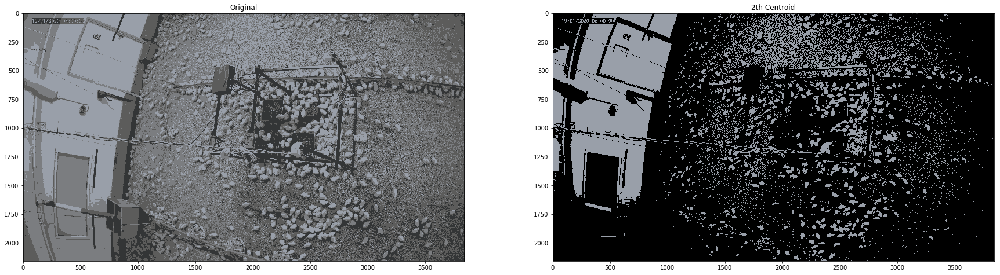

In [6]:
# make composite mask
c = 2
mask = cv2.inRange(res2, center[c] - (5, 5, 5), center[c] + (5, 5, 5))

# masked image
masked_frame = cv2.bitwise_and(res2, res2, mask=mask)

# quantised image in rgb format
res3 = cv2.cvtColor(res2, cv2.COLOR_BGR2RGB)

# masked quantised image in rgb format
masked_frame3 = cv2.cvtColor(masked_frame, cv2.COLOR_BGR2RGB)
fig, axs = plt.subplots(1, 2, figsize=(30, 30))
axs[0].imshow(res3)
axs[0].set_title('Original')

axs[1].imshow(masked_frame3)
axs[1].set_title('{}th Centroid'.format(c))
plt.show()


With K-Means clustering (k = 4 by experiment) it seems that the 2nd centroid is most suitable for chickens segmentation. But there are a lot of noise present in the image. Let's try to denoise the images with morphological transform.

In [7]:
# save the image
save = False
if save== True:
    cv2.imwrite('masked_frame.png', masked_frame)

## Morphological Transformation

In [8]:
from skimage.measure import regionprops, label
from statistics import mean

from skimage.draw import rectangle

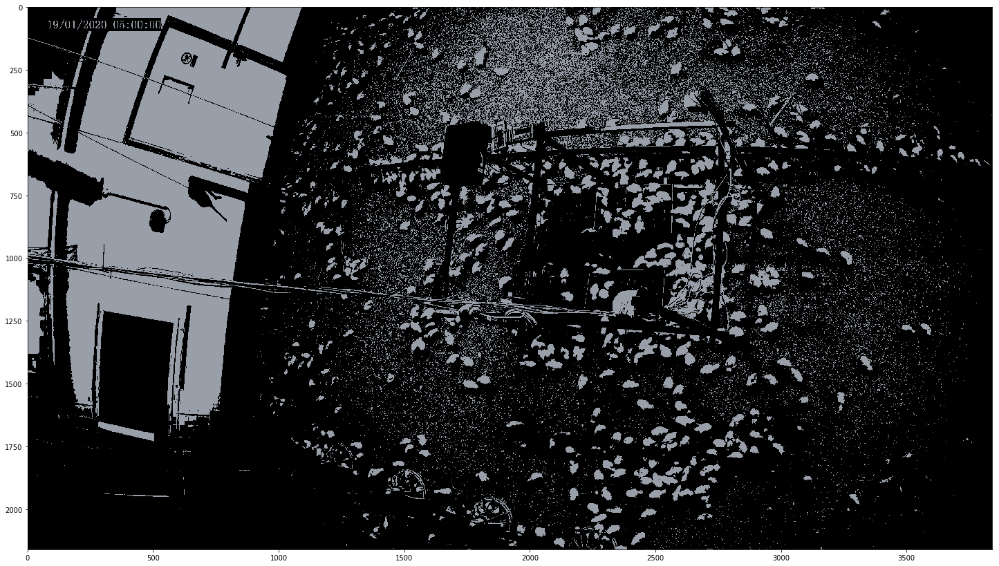

In [13]:
# read in saved img
img = cv2.imread('masked_frame.png')
frame = cv2.imread(imgs[3])
plt.figure(figsize=(25, 25))
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

There are way too much noise, a good practise is to remove them before extracting information out of the blobs.

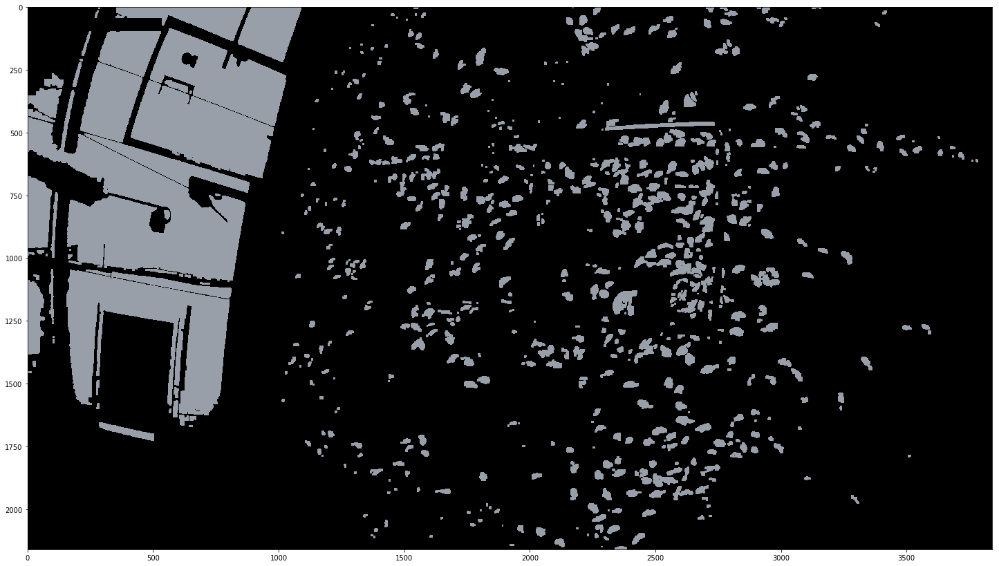

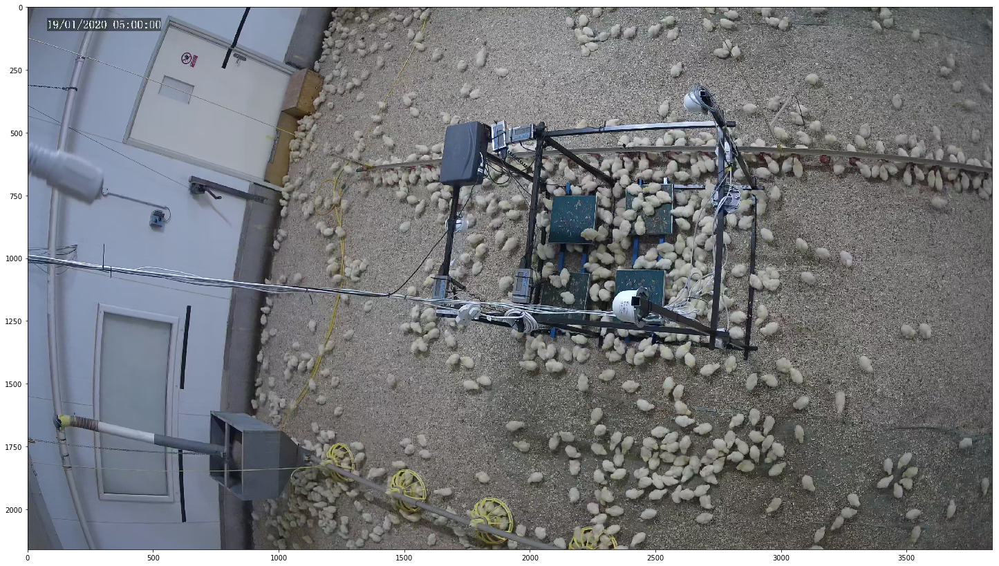

In [12]:
# hyperparameter (kernel size)
kernel = np.ones((8,8),np.uint8)

# opening means erosion follow by dilation (can be used for denoising)
opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel, iterations=1)
# closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel)

plt.figure(figsize=(25, 25))
plt.imshow(cv2.cvtColor(opening, cv2.COLOR_BGR2RGB))

plt.show()
plt.figure(figsize=(25, 25))
plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))


The next step is to remove blobs which are too big, for example the wall. Also, we wish to identify the clusters, hence we would also need the centroid of blob (hopefully this captures most are chickens if not we'll fix this later, we'll see). Let's use region props to get the centroids:

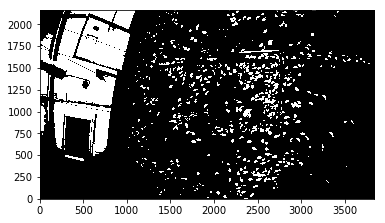

In [11]:
# grayscale
img2 = opening.copy()
gray = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
plt.imshow(np.flipud(gray), plt.gray(), origin='lower')

## Getting blob's centroid (regionprops)
Based on the area histogram, we'll select the thresholding area to be (20, 2000) which is just an estimate for chickens size.

In [14]:
coord_x = []
coord_y = []
bbs = []
allAreas = []
# change the area conditions to fine tune
regions = regionprops(label(gray>0))
for region in regions:
    allAreas.append(region.area)
    if region.area>20 and region.area<2000:
        y, x = region.centroid
        
        coord_x.append(x)
        coord_y.append(y)
        bbs.append(region.bbox)
coord_x = np.asarray(coord_x)
coord_y = np.asarray(coord_y)

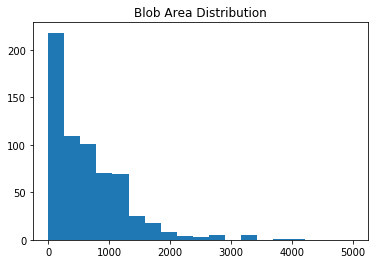

In [15]:
plt.hist(allAreas, bins=np.linspace(0, 5000, 20))
plt.title('Blob Area Distribution')
plt.show()

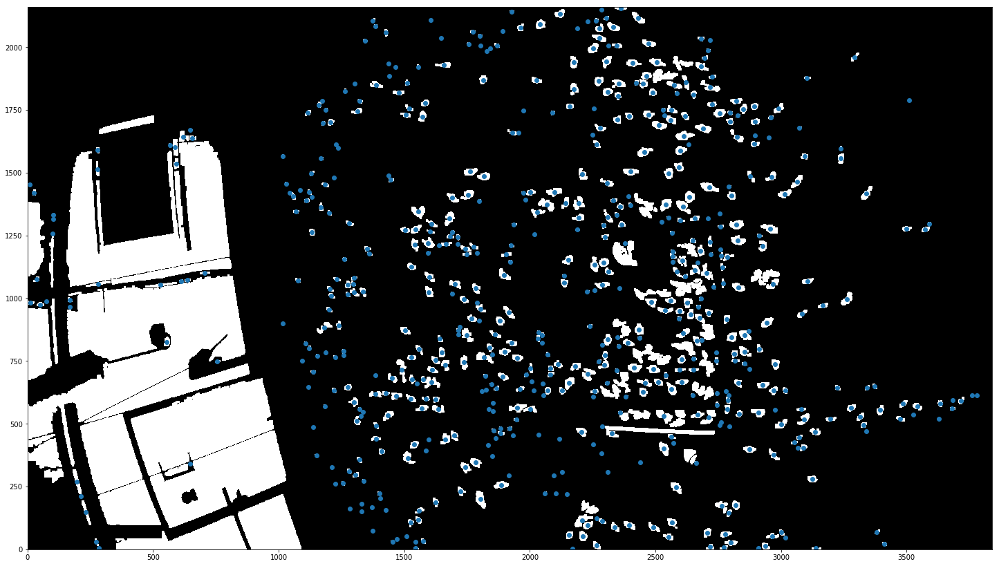

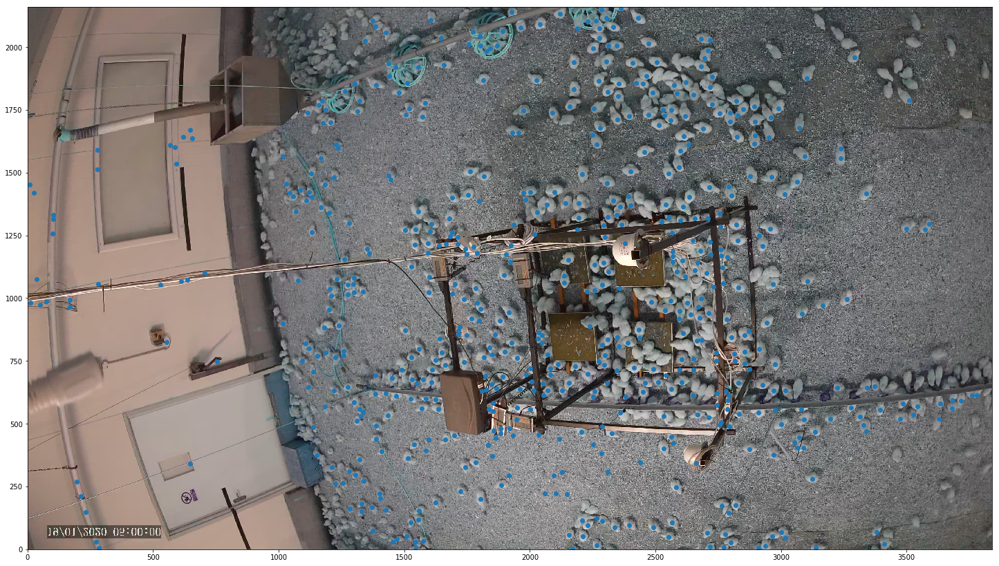

In [16]:
plt.figure(figsize=(25, 25))
plt.scatter(x=coord_x, y=coord_y)
plt.imshow((gray), origin='lower')


plt.figure(figsize=(25, 25))
plt.scatter(x=coord_x, y=coord_y)
plt.imshow((frame), origin='lower')

Clearly, some chickens are not detected due to lightning issues..We'll fix this in method B.

## Clustering
Since we do not know the exact numberr of clusters in this snapshot, furthermore, number of clusters is allowed to change in the video stream, a good starting point is to use clustering algorithms that do not require us to specify the number of clusters for example dbscan or mean shift.

## DBSCAN
Density based clustering, after some tweaking of the parameters, eps and min samples, I'm still not convinced that dbscan gives good results.

In [17]:
from sklearn.cluster import DBSCAN

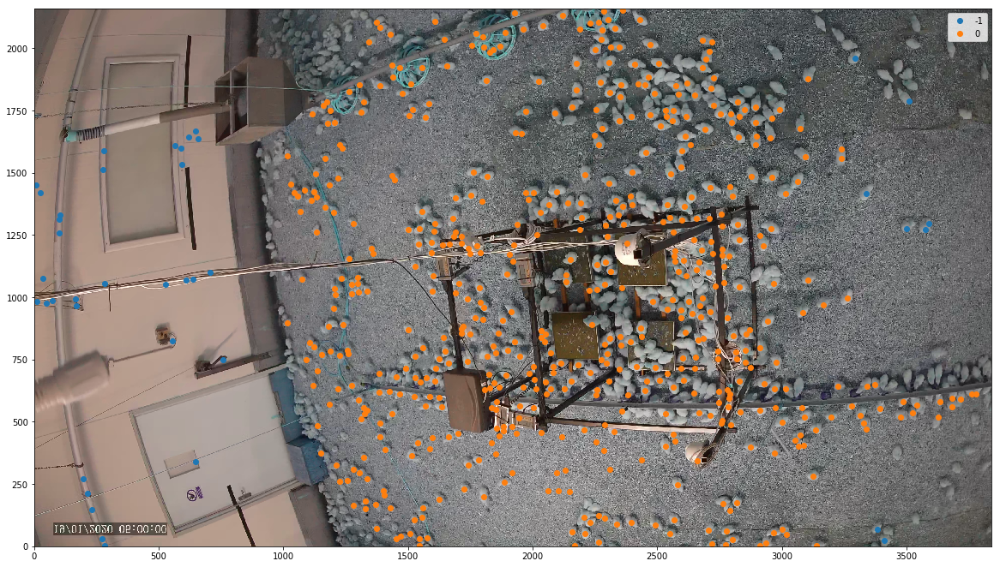

In [18]:
# Estimate scale
# 1 metre : 100 units

dbscan = DBSCAN(eps=250, min_samples=10)
dbscan.fit(np.array([coord_x, coord_y]).T)

plt.figure(figsize=(20, 20))
for c in np.unique(dbscan.labels_):
    plt.scatter(x=coord_x[dbscan.labels_==c], y=coord_y[dbscan.labels_==c], label=str(c))
plt.legend()

plt.imshow((frame), origin='lower')

## Mean Shift Clustering

In [19]:
from sklearn.cluster import MeanShift, estimate_bandwidth

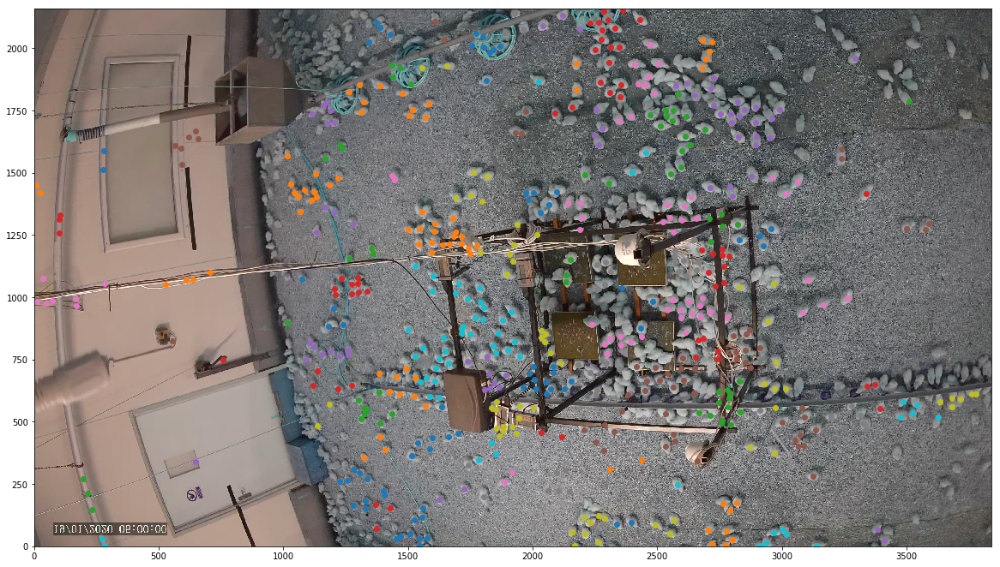

In [20]:
X = np.array([coord_x, coord_y]).T
# bw = estimate_bandwidth(X=X, n_samples=250) # bw too big

# hyperparameter bandwidth
bw = 100
ms = MeanShift(bandwidth=bw, bin_seeding=True)

ms.fit(X)


plt.figure(figsize=(20, 20))
for c in np.unique(ms.labels_):
    plt.scatter(x=coord_x[ms.labels_==c], y=coord_y[ms.labels_==c], label=str(c))

plt.imshow((frame), origin='lower')

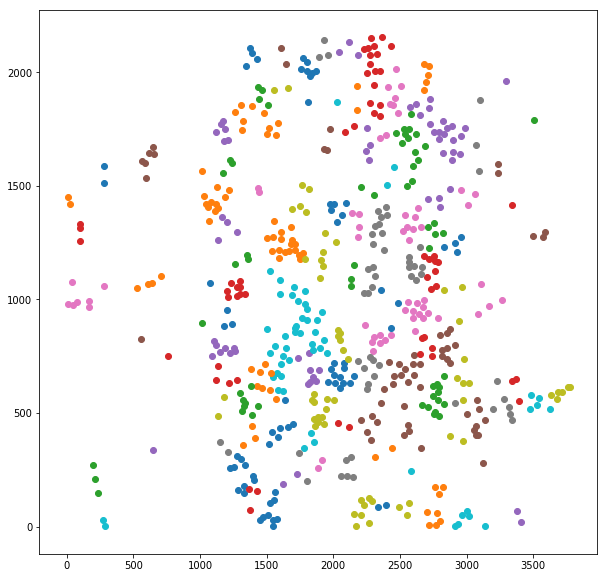

In [21]:
plt.figure(figsize=(10, 10))
for c in np.unique(ms.labels_):
    plt.scatter(x=coord_x[ms.labels_==c], y=coord_y[ms.labels_==c], label=str(c))


## Checkpoint
### Some Thoughts
At this point we have more or less managed to determine the chicken clusters. A baseline framework consists of 
1. k-means clustering -> 
2. global thresholding or masking -> 
3. morphological transformation-> 
4. region props to find chicken's centroid -> 
5. mean shift to detect clusters. 

### Insights
However, there are <b> two major problems </b>:
1. Too many false positive (wrongly identified chicken, this is a fundamental problem with the method used to detect chicken at the very early stage, k means colour quantisation(global thresholding)) -> Experiment on more robust algorithm for segmentation
2. Unable to detect some chicken at darker places. Again, this is a fundamental problem with global thresholding.

### Potential Improvements
The problem with global thresholding is that, we do not take local lighting conditions into account when detecting chickens. Also, we prespecified the number of clusters for k means clustering as k=4, this was kinda arbitrary. Potentially, we can improve the results with local thresholding methods.
For example:
1. Adaptive thresholding
2. Sliding window with DBSCAN (instead of k means clustering), but this could be expensive

Alternatively, we could pre process the image first with denoising kernels before applying k means clustering. Then maybe we can increase the probability of detection whiile lowering the false positive rate.
For example,
1. Gaussian smoothing
2. Median filter etc

## Method B: Adaptive thresholding

Text(0.5, 1.0, 'Applied adaptive thresholding')

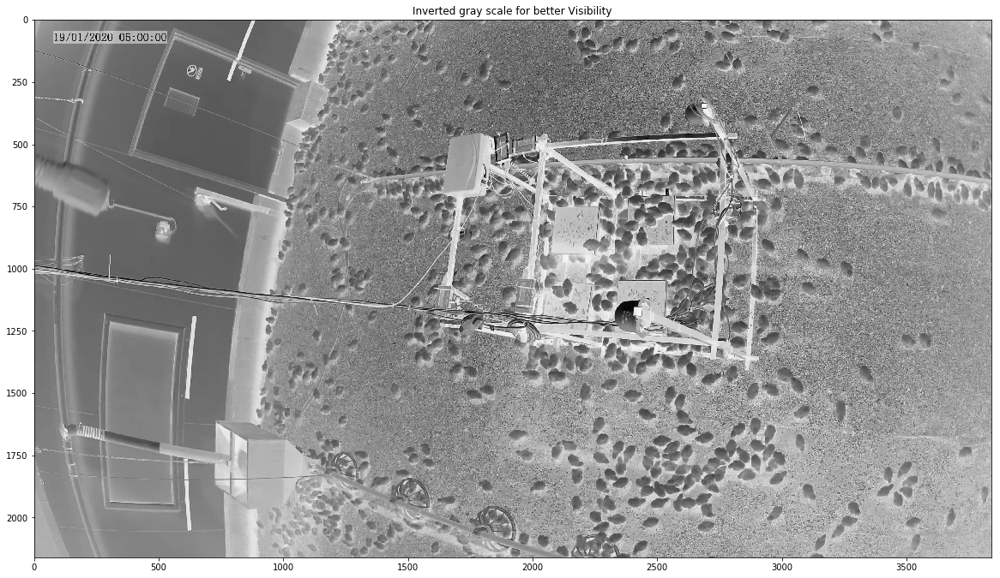

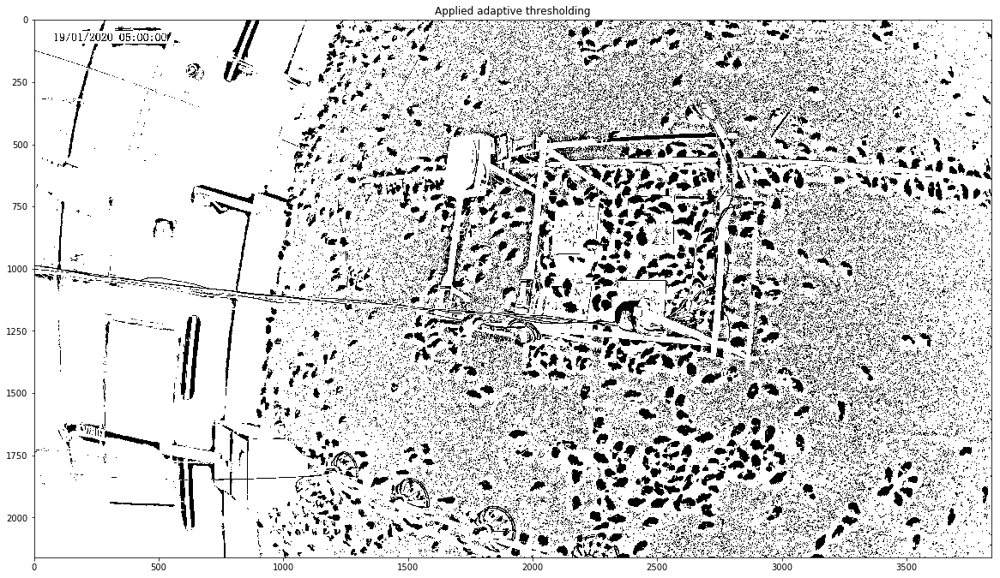

In [22]:
# Let's invert black- white for better visibility and detection of chicken
imagem = cv2.bitwise_not(cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY))

# Adaptive thres, experimented block size and c value
theresImg = cv2.adaptiveThreshold(imagem,255,cv2.ADAPTIVE_THRESH_MEAN_C,cv2.THRESH_BINARY,55,20)

plt.figure(figsize=(20, 20))
plt.imshow(imagem, 'gray')
plt.title('Inverted gray scale for better Visibility')
plt.figure(figsize=(20, 20))
plt.imshow(theresImg, 'gray')
plt.title('Applied adaptive thresholding')

## Morphological Transformation
As before, let's remove the noise.

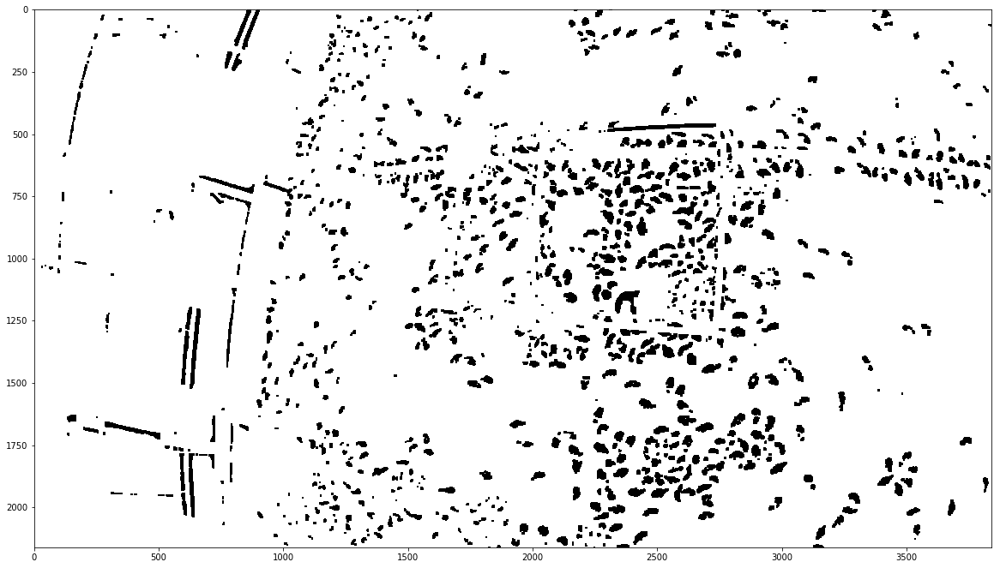

In [28]:
# hyperparameter (kernel size)
kernel = np.ones((8,8),np.uint8)

# Use closing since black-white inverted which means dilation follow by erosion (can be used for denoising)
closing = cv2.morphologyEx(theresImg, cv2.MORPH_CLOSE, kernel, iterations=1)

plt.figure(figsize=(20, 20))
plt.imshow(closing, 'gray')

In [29]:
coord_x = []
coord_y = []
bbs = []
allAreas = []
# change the area conditions to fine tune
regions = regionprops(label(closing<255))
for region in regions:
    allAreas.append(region.area)
#     (20, 2000)
    if region.area>20 and region.area<2500:
        y, x = region.centroid
        # To remove false positive
        if x>1000:
            coord_x.append(x)
            coord_y.append(y)
            bbs.append(region.bbox)
coord_x = np.asarray(coord_x)
coord_y = np.asarray(coord_y)

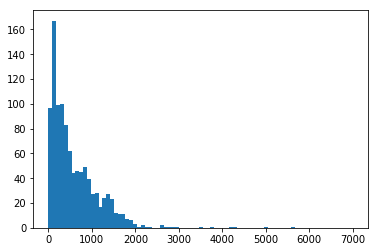

In [30]:
plt.hist(allAreas, bins=np.linspace(0, 7000, 80))
plt.show()

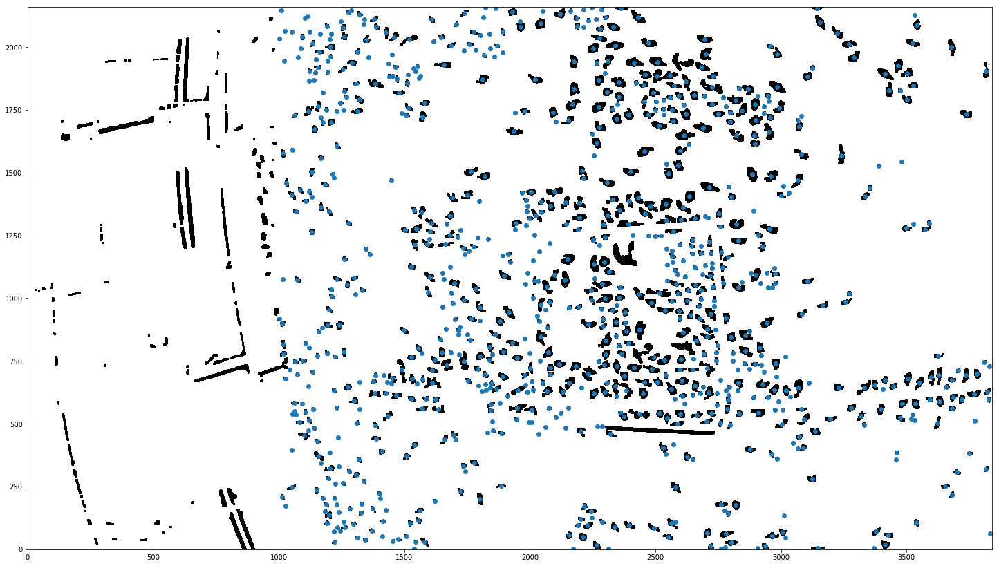

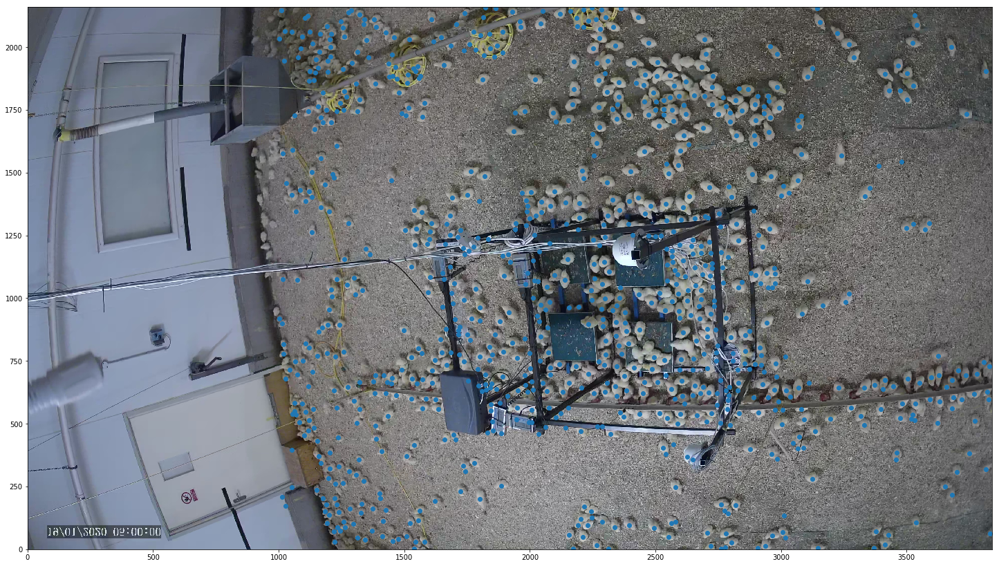

In [33]:
plt.figure(figsize=(25, 25))
plt.scatter(x=coord_x, y=coord_y)
plt.imshow((closing), origin='lower')


plt.figure(figsize=(25, 25))
plt.scatter(x=coord_x, y=coord_y)
plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB), origin='lower')

The detection rate increases and the false positive rate decreases. (Note I manually eliminate those centroids smaller than x=1000 which are definitely false positives. But even without that, the number of FP is still lesser than method A)

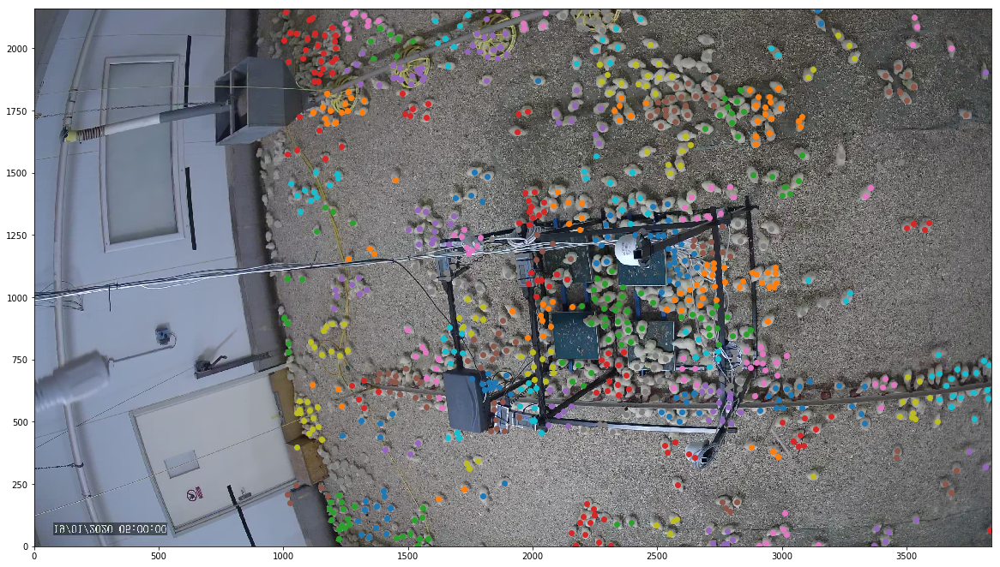

In [35]:
X = np.array([coord_x, coord_y]).T
# bw = estimate_bandwidth(X=X, n_samples=250) # bw too big

# hyperparameter bandwidth
bw = 100
ms = MeanShift(bandwidth=bw, bin_seeding=True)

ms.fit(X)


plt.figure(figsize=(20, 20))
for c in np.unique(ms.labels_):
    plt.scatter(x=coord_x[ms.labels_==c], y=coord_y[ms.labels_==c], label=str(c))

plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB), origin='lower')

Visually, this seems to be a better chicken clusters detection framework. With better search of hyperparameters, we might be able to reduce the number of false positives(From what we can observed, almost all chickens are correctly identified so the probability of detection is good enough for now).

# 2. Clusters Analysis
The following section aims to analyse the within-cluster-distances of the chickens. This is important for several reasons mentioned before:
1. To control spread of short range infectious diseases or parasites
2. To ensure spaced out and sufficient distribution of food and water
3. To ensure sufficient activty space for chickens

We will be using the chicken clusters identified by adaptive thresholding method since it appears to have higher probability of detection.

Firstly, let's compute the euclidean distance from the clusters centroid. Next, we'll compute the average distances from the centroids within the clusters.

In [36]:
avg_distance = {}

for ix, (x, y) in enumerate(zip(coord_x, coord_y)):
    # calculate the euclidean distance from respective centroid
    centroid_number = ms.labels_[ix]
    distance = np.linalg.norm(np.array([x, y])-np.array(ms.cluster_centers_[centroid_number]))
    
    # key: centroid number, val: Euclidean distance
    if centroid_number in avg_distance:
        avg_distance[centroid_number].append(distance)
    else:
        avg_distance[centroid_number] = [distance]

In [37]:
for key, val in avg_distance.items():
    avg_distance[key] = [mean(val), len(val)]

<b>Definition of a close cluster</b>: Say 5 chickens within ~100 cm radius is considered as a close clusters and is unfavourable.

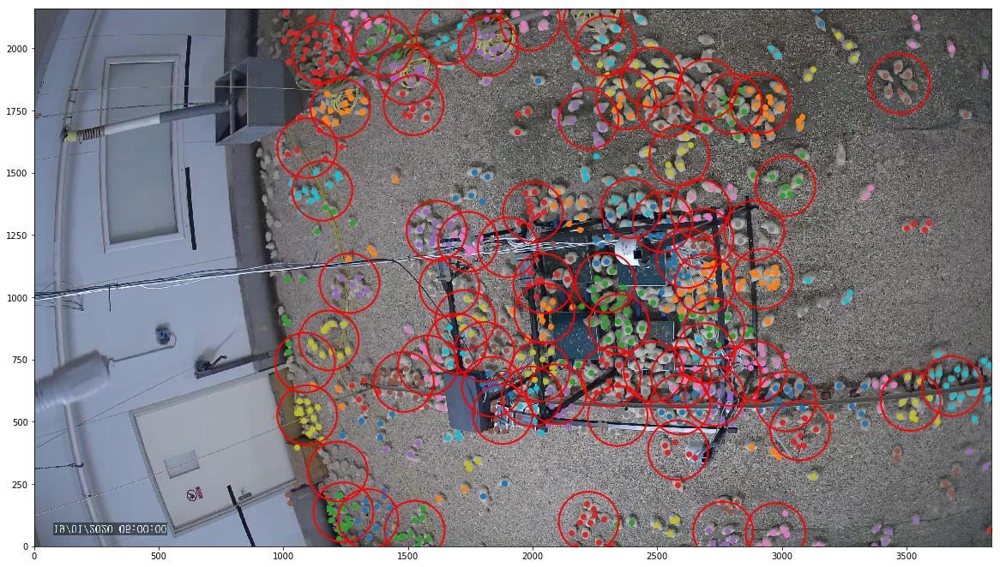

In [39]:
dist_thres = 100
quantity_thres = 5

# average distance within dist thres but quantity above quantity thres
close_clusters = [key for key in avg_distance if avg_distance[key][0]<=dist_thres and avg_distance[key][1]>quantity_thres]
close_centroids = ms.cluster_centers_[close_clusters]

# Mean Shift Clustering
X = np.array([coord_x, coord_y]).T
bw = 100
ms = MeanShift(bandwidth=bw, bin_seeding=True)

ms.fit(X)


# Plot chicken detected
plt.figure(figsize=(20, 20))
for c in np.unique(ms.labels_):
    plt.scatter(x=coord_x[ms.labels_==c], y=coord_y[ms.labels_==c], label=str(c))

plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB), origin='lower')

# Draw circle to show identified close clusters
for x, y in close_centroids:
    cir = plt.Circle((x, y), radius=dist_thres*1.2, color='r', fill=False, linewidth=2.0)
    ax = plt.gca()
    ax.add_artist(cir)
plt.show()

With a bit of hyperparameters tweaking, I think this is the best I could achieve. The identified <b> close clusters </b>(based on how I defined it, 5 chickens within 1 metre radius calculated from cluster centroid) are <b> circled in red </b> while chicken from the <b> same clusters </b> are overlaid with <b> dots of the same colour </b> .

## Insights
From this analysis, most close clusters are concentrated at the centre and along the (pipe?) on the floor, could be where they drink/ eat. Although there are a few concentrated at the side, near the wall. Naturally, chickens will gravitate towards their essentials causing them to concentrate in certain regions, to make use of the space more optimally, consider increasing the number of food/ water stations and some soft or partial partitions to make space for the chickens.

# Remark
So what's next? First of all, with the processing speed of these methods, it's unlikely that we will be able to process the video frames in real time. Maybe it's time for deep learning for near real time chicken segmentation/ detection. If that's the case this piece of work can potentially be used to partially automate the labelling of data for the training of more sophisticated deep learning models. With sufficiently trained model, we an then delpoy DL models for real time cluster monitoring. This is a huge save in effort consider the number of chickens one have to label.

# Q2 If we have access to many of these images

# Anomaly detection in surveillance video
If I have access to many of these images(video frames), I'll be most interested to build an anomalous activity detection system. In the long term, this will be a 2 steps framework, the first step is to identify chickens involved in anomalous activities and then tag or track the chicken so that the farmer can take appropriate actions. I will illustrate the first step.

This helps to remove problematic chicken(s) from the flock to avoid bad consequences. For example, if an aggressive chicken was brought in and it starts to peck other chickens, this can easily trigger an uncontrolled fight, resulting in losses to the farmer. Our system will detect the anomalous pecking instance at its first occurrence and tag or track the chickens involved in the fight. Based on the alert and analytics from our system, the farmer can then take appropriate action, eg remove the aggressive chicken etc. If more and more chickens exhibit anomalous behaviours in a short time span, it can also imply unfavourable living conditions for example, excessive lightning, overheating and overcrowding. The idea is the farmer can rely on this system to have continuous and automatic monitoring on his chicken.

## Data Collection
Primary data comes in the form of video frames (streaming from surveillance), we can also monitor other sensory information of the surroundings like temperature, brightness etc. For primary data, a week of video recording should be sufficient

## Preprocessing
Firstly, anomalous behaviours of chicken can come in many forms. Hence, training deep learning classifiers in supervised manner is less suitable as there might be uncategorised future anomalous activities. Not to mentioned that, manual labelling of video frames is tedious. A sensible approach and good starting point is to go for semi-supervised approach, for example, by using an LSTM autoencoder. The idea is to train the lstm autoencoder with regular chicken behaviours in hope that the model will be able to recognise unfamiliar activities when deployed.

To prepare the data:
(0. Decide whether to use coloured video frames or black and white. Based on criterions like processing speed, memory usage, training time, accuracy etc)
1. Define a sliding window with a width of w(say 10) and partition w video frames sequentially in time. The first 9 frames will be the input and the last frame will be the reconstructed output frame(to be predicted by the LSTM autoencoder)
2. Min max normalise or standardise the pixel values if necessary.
3. Decide whether to perform data augmentation or not. Essentially we can choose segments of videos with noo anomalous activities and performm data augmentation. Example of data augmentation, lighting augmentation(remember that the video streams 24/7 at different lighting conditions) and skipping strides.


## Network Architecture 
General approach:
1. Start with models with mid level complexity (a few layers of conv net and lstm cells) tune and make it work. 
2. Then reduce its complexity while ensuring its still working. 

Essentials:
1. Spatial Encoder: conv layers
2. Temporal encoder: lstm conv layers
3. Bottleneck
4. Tempooral decoder: lstm conv layers
5. Spatial decoder: conv layers

## Training
Define loss function and anomaly metric:
We want the autoencoder to reconstruct temporal data:
1. Define a euclidean loss l2 norm between the actual and reconstructed video frame at time t.
2. The sequence reconstruction loss is the sum of loss in 1. for a consecutive of 10 frames.
3. Finally, min max norm the seq. reconstruction lost so that the metric falls in between 0 and 1. This will be our anomaly  metric.

Also, when training, split the video frames with regular chicken activities into training and validation splits. Make sure to keep track of the losses to check for overfitting/ underfitting issues.